<a href="https://colab.research.google.com/github/prammmoe/yolov9-94-map/blob/main/train_yolo9_data_mining.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Check GPU Details

In [ ]:
!nvidia-smi

Wed Apr  3 12:47:50 2024       
+---------------------------------------------------------------------------------------+
| NVIDIA-SMI 535.104.05             Driver Version: 535.104.05   CUDA Version: 12.2     |
|-----------------------------------------+----------------------+----------------------+
| GPU  Name                 Persistence-M | Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp   Perf          Pwr:Usage/Cap |         Memory-Usage | GPU-Util  Compute M. |
|                                         |                      |               MIG M. |
|=========================================+======================+======================|
|   0  Tesla T4                       Off | 00000000:00:04.0 Off |                    0 |
| N/A   49C    P8              10W /  70W |      0MiB / 15360MiB |      0%      Default |
|                                         |                      |                  N/A |
+-----------------------------------------+----------------------+--

# Initiate Root Directory

For safety reasons ...

In [ ]:
import os
HOME = os.getcwd()
print(HOME)

/content


# Clone fork repository

In [ ]:
!git clone https://github.com/prammmoe/yolov9-vehicle-detection.git
%cd yolov9-vehicle-detection
!pip install -r requirements.txt -q

Cloning into 'yolov9-vehicle-detection'...
remote: Enumerating objects: 5680, done.
remote: Counting objects: 100% (55/55), done.
remote: Compressing objects: 100% (53/53), done.
remote: Total 5680 (delta 5), reused 20 (delta 2), pack-reused 5625
Receiving objects: 100% (5680/5680), 230.19 MiB | 37.68 MiB/s, done.
Resolving deltas: 100% (119/119), done.
/content/yolov9-vehicle-detection
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 207.3/207.3 kB 2.3 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 8.4/8.4 MB 24.8 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 62.7/62.7 kB 7.6 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.6/1.6 MB 80.1 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 23.7/23.7 MB 49.2 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 823.6/823.6 kB 3.7 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 14.1/14.1 MB 60.7 MB/s eta 0:00:00
     

# Download pretrained weights

In [ ]:
!wget -P {HOME}/weights -q https://github.com/WongKinYiu/yolov9/releases/download/v0.1/yolov9-c.pt
!wget -P {HOME}/weights -q https://github.com/WongKinYiu/yolov9/releases/download/v0.1/yolov9-e.pt
!wget -P {HOME}/weights -q https://github.com/WongKinYiu/yolov9/releases/download/v0.1/gelan-c.pt
!wget -P {HOME}/weights -q https://github.com/WongKinYiu/yolov9/releases/download/v0.1/gelan-e.pt

Check weights

In [ ]:
!ls -la {HOME}/weights

total 402440
drwxr-xr-x 2 root root      4096 Apr  3 03:46 .
drwxr-xr-x 1 root root      4096 Apr  3 03:46 ..
-rw-r--r-- 1 root root  51508261 Feb 18 12:36 gelan-c.pt
-rw-r--r-- 1 root root 117203713 Feb 18 12:36 gelan-e.pt
-rw-r--r-- 1 root root 103153312 Feb 18 12:36 yolov9-c.pt
-rw-r--r-- 1 root root 140217688 Feb 18 12:36 yolov9-e.pt


# Train

In [ ]:
%cd /content/yolov9-vehicle-detection

!python train_dual.py \
--batch 16 --epochs 30 --img 640 --device 0 --min-items 0 --close-mosaic 15 \
--data data/datasets/data.yaml \
--weights {HOME}/weights/yolov9-e.pt \
--cfg models/detect/yolov9-e.yaml \
--hyp hyp.scratch-high.yaml

/content/yolov9-vehicle-detection
2024-04-02 20:06:38.027971: E external/local_xla/xla/stream_executor/cuda/cuda_dnn.cc:9261] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
2024-04-02 20:06:38.028025: E external/local_xla/xla/stream_executor/cuda/cuda_fft.cc:607] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
2024-04-02 20:06:38.152638: E external/local_xla/xla/stream_executor/cuda/cuda_blas.cc:1515] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered
2024-04-02 20:06:39.274887: W tensorflow/compiler/tf2tensorrt/utils/py_utils.cc:38] TF-TRT Warning: Could not find TensorRT
train_dual: weights=/content/weights/yolov9-e.pt, cfg=models/detect/yolov9-e.yaml, data=data/datasets/data.yaml, hyp=hyp.scratch-high.yaml, epochs=30, batch_size=8, imgsz=640, rect=False, resume=False, nosav

# Examine Training Results

**NOTE:** By default, the results of each subsequent training sessions are saved in `{HOME}/yolov9/runs/train/`, in directories named `exp`, `exp2`, `exp3`, ... You can override this behavior by using the `--name` parameter.

In [ ]:
!ls {HOME}/yolov9-vehicle-detection/runs/train/exp/

confusion_matrix.png				    PR_curve.png	   val_batch0_pred.jpg
events.out.tfevents.1712088400.efb8b736b0d0.3049.0  R_curve.png		   val_batch1_labels.jpg
F1_curve.png					    results.csv		   val_batch1_pred.jpg
hyp.yaml					    results.png		   val_batch2_labels.jpg
labels_correlogram.jpg				    train_batch0.jpg	   val_batch2_pred.jpg
labels.jpg					    train_batch1.jpg	   weights
opt.yaml					    train_batch2.jpg
P_curve.png					    val_batch0_labels.jpg


# Display Evaluation Graph

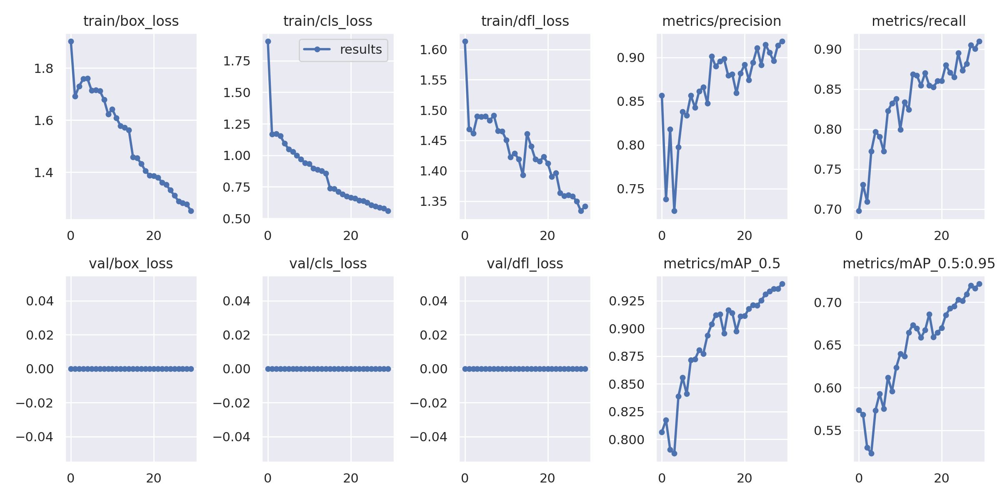

In [ ]:
from IPython.display import Image

Image(filename=f"{HOME}/yolov9-vehicle-detection/runs/train/exp/results.png", width=1000)

# Display Confussion Matrix

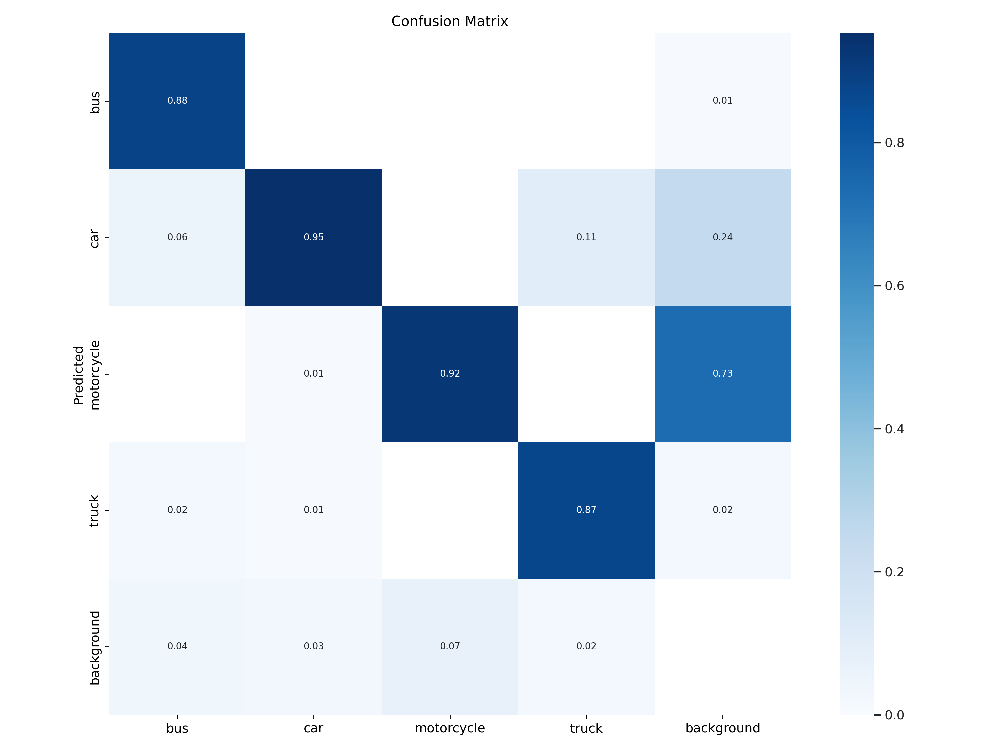

In [ ]:
from IPython.display import Image

Image(filename=f"{HOME}/yolov9-vehicle-detection/runs/train/exp/confusion_matrix.png", width=1000)

# Validate

In [ ]:
%cd {HOME}/yolov9-vehicle-detection

!python val_dual.py \
--img 640 --batch 8 --conf 0.001 --iou 0.7 --device 0 \
--data data/datasets/data.yaml \
--weights {HOME}/yolov9-vehicle-detection/runs/train/exp/weights/best.pt

/content/yolov9-vehicle-detection
val_dual: data=data/datasets/data.yaml, weights=['/content/yolov9-vehicle-detection/runs/train/exp/weights/best.pt'], batch_size=8, imgsz=640, conf_thres=0.001, iou_thres=0.7, max_det=300, task=val, device=0, workers=8, single_cls=False, augment=False, verbose=False, save_txt=False, save_hybrid=False, save_conf=False, save_json=False, project=runs/val, name=exp, exist_ok=False, half=False, dnn=False, min_items=0
YOLO 🚀 00fdf78 Python-3.10.12 torch-2.2.1+cu121 CUDA:0 (Tesla V100-SXM2-16GB, 16151MiB)

Fusing layers... 
yolov9-e summary: 839 layers, 68552440 parameters, 0 gradients, 240.7 GFLOPs
val: Scanning /content/yolov9-vehicle-detection/data/datasets/valid/labels.cache... 406 images, 2 backgrounds, 0 corrupt: 100% 406/406 [00:00<?, ?it/s]
                 Class     Images  Instances          P          R      mAP50   mAP50-95: 100% 51/51 [00:22<00:00,  2.31it/s]
                   all        406       4933      0.918       0.91       0.94      0.723

In [ ]:
%cd ..

/content


# Inference

In [ ]:
!python detect_dual.py \
--img 1280 --conf 0.6 --device 0 \
--weights {HOME}/yolov9-vehicle-detection/runs/train/exp/weights/best.pt \
--source data/datasets/test/images

detect_dual: weights=['/content/yolov9-vehicle-detection/runs/train/exp/weights/best.pt'], source=data/datasets/test/images, data=data/coco128.yaml, imgsz=[1280, 1280], conf_thres=0.6, iou_thres=0.45, max_det=1000, device=0, view_img=False, save_txt=False, save_conf=False, save_crop=False, nosave=False, classes=None, agnostic_nms=False, augment=False, visualize=False, update=False, project=runs/detect, name=exp, exist_ok=False, line_thickness=3, hide_labels=False, hide_conf=False, half=False, dnn=False, vid_stride=1
YOLO 🚀 00fdf78 Python-3.10.12 torch-2.2.1+cu121 CUDA:0 (Tesla V100-SXM2-16GB, 16151MiB)

Fusing layers... 
yolov9-e summary: 839 layers, 68552440 parameters, 0 gradients, 240.7 GFLOPs
image 1/195 /content/yolov9-vehicle-detection/data/datasets/test/images/1689957051-8314376_jpg.rf.9ab15eca9966dce1b5da7144af6eaf10.jpg: 1280x1280 2 motorcycles, 102.6ms
image 2/195 /content/yolov9-vehicle-detection/data/datasets/test/images/1689957096-906131_jpg.rf.40895413625f73d36e1756b2c777

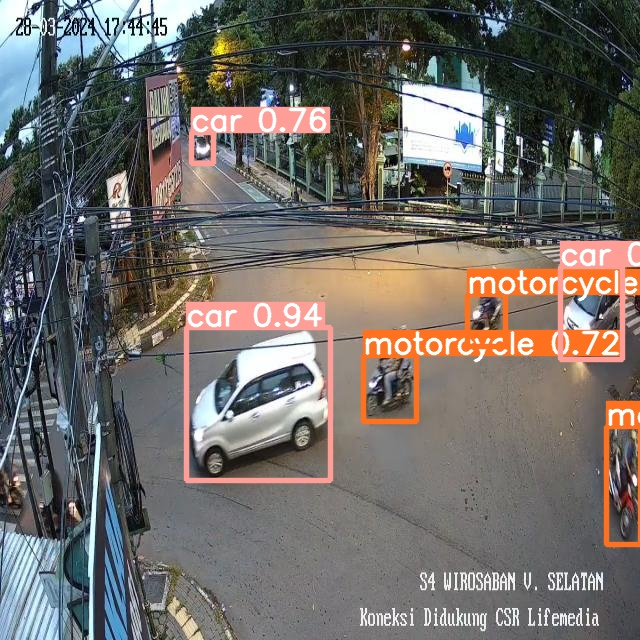

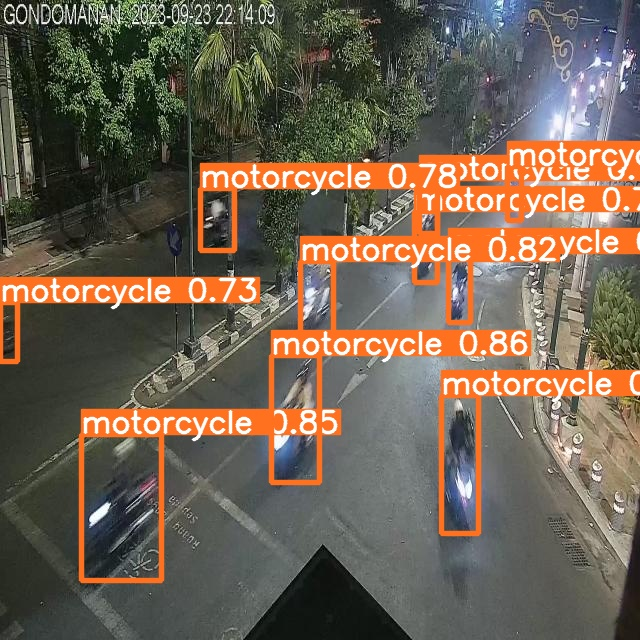

In [ ]:
import glob

from IPython.display import Image, display

for image_path in glob.glob(f'{HOME}/yolov9-vehicle-detection/runs/detect/exp2/*.jpg')[:2]:
      display(Image(filename=image_path, width=600))

In [ ]:
%pwd

'/content/yolov9-vehicle-detection'

In [ ]:
!zip -r yolov9.zip /content/yolov9-vehicle-detection

  adding: content/yolov9-vehicle-detection/ (stored 0%)
  adding: content/yolov9-vehicle-detection/segment/ (stored 0%)
  adding: content/yolov9-vehicle-detection/segment/train.py (deflated 69%)
  adding: content/yolov9-vehicle-detection/segment/val.py (deflated 68%)
  adding: content/yolov9-vehicle-detection/segment/predict.py (deflated 68%)
  adding: content/yolov9-vehicle-detection/figure/ (stored 0%)
  adding: content/yolov9-vehicle-detection/figure/multitask.png (deflated 0%)
  adding: content/yolov9-vehicle-detection/figure/performance.png (deflated 2%)
  adding: content/yolov9-vehicle-detection/figure/horses_prediction.jpg (deflated 1%)
  adding: content/yolov9-vehicle-detection/train_dual.py (deflated 70%)
  adding: content/yolov9-vehicle-detection/tools/ (stored 0%)
  adding: content/yolov9-vehicle-detection/tools/reparameterization.ipynb (deflated 89%)
  adding: content/yolov9-vehicle-detection/detect_gpu.sh (deflated 19%)
  adding: content/yolov9-vehicle-detection/utils/ (st

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
%cd /content/yolov9-vehicle-detection/

/content/yolov9-vehicle-detection


In [ ]:
!cp -r yolov9-vehicle-detection /content/drive/MyDrive/yolov9-vehicle-detection

In [ ]:
!cp /content/yolov9-vehicle-detection/yolov9.zip /content/drive/MyDrive/

In [ ]:
!gdown "https://drive.google.com/uc?id=1rjBn8Fl1E_9d0EMVtL24S9aNQOJAveR5&confirm=t"

Downloading...
From: https://drive.google.com/uc?id=1rjBn8Fl1E_9d0EMVtL24S9aNQOJAveR5&confirm=t
To: /content/yolov9-vehicle-detection/test3.mp4
100% 4.98M/4.98M [00:00<00:00, 37.0MB/s]


# Implementing DeepSORT

In [ ]:
from IPython.display import HTML
from base64 import b64encode
def play_video(filename):
  html = ''
  video = open(filename,'rb').read()
  src = 'data:video/mp4;base64,' + b64encode(video).decode()
  html += fr'<video width=900 controls autoplay loop><source src="%s" type="video/mp4"></video>' % src
  return HTML(html)

In [ ]:
play_video("/content/yolov9-vehicle-detection/test3.mp4")

In [ ]:
SOURCE_VIDEO_PATH = "/content/yolov9-vehicle-detection/test3.mp4"
OUTPUT_VIDEO_PATH = "/content/output.mp4"
BLUR_ID = None
CONF = 0.6
CLASS_ID = None

In [ ]:
import cv2
import torch
import time
import colorsys
import numpy as np
from absl import app, flags
from absl.flags import FLAGS
from deep_sort_realtime.deepsort_tracker import DeepSort
from models.common import DetectMultiBackend, AutoShape

In [ ]:
def draw_corner_rect(img, bbox, line_length=30, line_thickness=5, rect_thickness=1,
                     rect_color=(255, 0, 255), line_color=(0, 255, 0)):
    x, y, w, h = bbox
    x1, y1 = x + w, y + h

    if rect_thickness != 0:
        cv2.rectangle(img, bbox, rect_color, rect_thickness)

    # Top Left  x, y
    cv2.line(img, (x, y), (x + line_length, y), line_color, line_thickness)
    cv2.line(img, (x, y), (x, y + line_length), line_color, line_thickness)

    # Top Right  x1, y
    cv2.line(img, (x1, y), (x1 - line_length, y), line_color, line_thickness)
    cv2.line(img, (x1, y), (x1, y + line_length), line_color, line_thickness)

    # Bottom Left  x, y1
    cv2.line(img, (x, y1), (x + line_length, y1), line_color, line_thickness)
    cv2.line(img, (x, y1), (x, y1 - line_length), line_color, line_thickness)

    # Bottom Right  x1, y1
    cv2.line(img, (x1, y1), (x1 - line_length, y1), line_color, line_thickness)
    cv2.line(img, (x1, y1), (x1, y1 - line_length), line_color, line_thickness)

    return img


In [ ]:
cap = cv2.VideoCapture(SOURCE_VIDEO_PATH)

frame_width = int(cap.get(cv2.CAP_PROP_FRAME_WIDTH))
frame_height = int(cap.get(cv2.CAP_PROP_FRAME_HEIGHT))
fps = int(cap.get(cv2.CAP_PROP_FPS))
# video writer objects
fourcc = cv2.VideoWriter_fourcc(*'mp4v')
writer = cv2.VideoWriter(OUTPUT_VIDEO_PATH, fourcc, fps, (frame_width, frame_height))

# Initialize the DeepSort tracker
tracker = DeepSort(max_age=50)
# select device (CPU or GPU)
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
print(f"Using:{device}")
# Load YOLO model
model = DetectMultiBackend(weights='/content/best.pt',device=device, fuse=True)
model = AutoShape(model)

# Load the COCO class labels
classes_path = "/content/class.txt"
with open(classes_path, "r") as f:
  class_names = f.read().strip().split("\n")

# Create a list of random colors to represent each class
np.random.seed(42)
colors = np.random.randint(0, 255, size=(len(class_names), 3))

# FPS and vehicle count variables
frame_count = 0
start_time = time.time()
vehicle_count = 0  # Initialize vehicle count

while True:
  ret, frame = cap.read()
  if not ret:
      break
  # Run model on each frame
  results = model(frame)
  detect = []
  for det in results.pred[0]:
    label, confidence, bbox = det[5], det[4], det[:4]
    x1, y1, x2, y2 = map(int, bbox)
    class_id = int(label)

    # Filter out weak detections by confidence threshold and class_id
    if CLASS_ID is None:
        if confidence < CONF:
            continue
    else:
        if class_id != CLASS_ID or confidence < CONF:
            continue

    detect.append([[x1, y1, x2 - x1, y2 - y1], confidence, class_id])

  # Filter tracks based on valid class IDs
  tracks = tracker.update_tracks(detect, frame=frame)
  filtered_tracks = []
  for track in tracks:
    if not track.is_confirmed():
      continue
    class_id = track.get_det_class()
    if 0 <= class_id < len(class_names):  # Check if class_id is valid
      filtered_tracks.append(track)
      vehicle_count += 1  # Increment count for each identified vehicle
    # Update vehicle count text
    count_text = f"Vehicles Counted: {vehicle_count}"

  # Use filtered_tracks for drawing bounding boxes and labels
  for track in filtered_tracks:
    track_id = track.track_id
    ltrb = track.to_ltrb()
    class_id = track.get_det_class()
    x1, y1, x2, y2 = map(int, ltrb)
    color = colors[class_id]
    B, G, R = map(int, color)
    text = f"{track_id} - {class_names[class_id]}"

    cv2.putText(frame, count_text, (10, 30), cv2.FONT_HERSHEY_SIMPLEX, 1, (0, 0, 0), 2)
    frame = draw_corner_rect(frame, (x1, y1, x2 - x1, y2 - y1), line_length=15, line_thickness=3, rect_thickness=1, rect_color=(B, G, R), line_color=(R, G, B))
    cv2.rectangle(frame, (x1, y1), (x2, y2), (B, G, R), 2)
    cv2.rectangle(frame, (x1 - 1, y1 - 20), (x1 + len(text) * 10, y1), (B, G, R), -1)
    cv2.putText(frame, text, (x1 + 5, y1 - 7), cv2.FONT_HERSHEY_SIMPLEX, 0.5, (255, 255, 255), 2)


    # Apply Gaussian Blur
    if BLUR_ID is not None and class_id == BLUR_ID:
      if 0 <= x1 < x2 <= frame.shape[1] and 0 <= y1 < y2 <= frame.shape[0]:
        frame[y1:y2, x1:x2] = cv2.GaussianBlur(frame[y1:y2, x1:x2], (99, 99), 3)

  writer.write(frame)

  frame_count += 1
  if frame_count % 10 == 0:
    elapsed_time = time.time() - start_time
    fps_calc = frame_count / elapsed_time
    print(f"FPS: {fps_calc:.2f}")


cap.release()
writer.release()

Using:cpu


Fusing layers... 
yolov9-e summary: 839 layers, 68552440 parameters, 0 gradients, 240.7 GFLOPs
Adding AutoShape... 


FPS: 2.67
FPS: 2.61
FPS: 2.66
FPS: 2.69
FPS: 2.65
FPS: 2.63
FPS: 2.65
FPS: 2.69
FPS: 2.73
FPS: 2.67
FPS: 2.66
FPS: 2.66
FPS: 2.65
FPS: 2.67
FPS: 2.67
FPS: 2.66
FPS: 2.65
FPS: 2.64
FPS: 2.64
FPS: 2.63
FPS: 2.63
FPS: 2.63
FPS: 2.64
FPS: 2.64
FPS: 2.65
FPS: 2.65
FPS: 2.65
FPS: 2.65
FPS: 2.65
FPS: 2.64
FPS: 2.63
FPS: 2.62
FPS: 2.62
FPS: 2.62
FPS: 2.63
FPS: 2.62
FPS: 2.61
FPS: 2.61
FPS: 2.61
FPS: 2.61
FPS: 2.61
FPS: 2.61
FPS: 2.61
FPS: 2.61
FPS: 2.61
FPS: 2.61
FPS: 2.62
FPS: 2.61
FPS: 2.62
FPS: 2.62


In [ ]:
play_video("/content/test3.mp4")

In [ ]:
!ffmpeg -hide_banner -loglevel error -i /content/output.mp4 -vcodec libx264 /content/test3_output.mp4 -y
play_video("/content/test3_output.mp4")

In [ ]:
import cv2
import torch
import numpy as np
from deep_sort_realtime.deepsort_tracker import DeepSort
from models.common import DetectMultiBackend, AutoShape

# Config value
video_path = "cctv_jlagran.mp4"
conf_threshold = 0.5
tracking_class = 4 # None: track all

# Khởi tạo DeepSort
tracker = DeepSort(max_age=30)

# Khởi tạo YOLOv9
device = "cuda" # "cuda": GPU, "cpu": CPU, "mps:0"
model  = DetectMultiBackend(weights="runs/train/exp/weights/best.pt", device=device, fuse=True )
model  = AutoShape(model)

# Load classname từ file classes.names
with open("class.names") as f:
    class_names = f.read().strip().split('\n')

colors = np.random.randint(0,255, size=(len(class_names),3 ))
tracks = []

# Khởi tạo VideoCapture để đọc từ file video
cap = cv2.VideoCapture(video_path)

# Tiến hành đọc từng frame từ video
while True:
    # Đọc
    ret, frame = cap.read()
    if not ret:
        continue
    # Đưa qua model để detect
    results = model(frame)

    detect = []
    for detect_object in results.pred[0]:
        label, confidence, bbox = detect_object[5], detect_object[4], detect_object[:4]
        x1, y1, x2, y2 = map(int, bbox)
        class_id = int(label)

        if tracking_class is None:
            if confidence < conf_threshold:
                continue
        else:
            if class_id != tracking_class or confidence < conf_threshold:
                continue

        detect.append([ [x1, y1, x2-x1, y2 - y1], confidence, class_id ])


    # Cập nhật,gán ID băằng DeepSort
    tracks = tracker.update_tracks(detect, frame = frame)

    # Vẽ lên màn hình các khung chữ nhật kèm ID
    for track in tracks:
        if track.is_confirmed():
            track_id = track.track_id

            # Lấy toạ độ, class_id để vẽ lên hình ảnh
            ltrb = track.to_ltrb()
            class_id = track.get_det_class()
            x1, y1, x2, y2 = map(int, ltrb)
            color = colors[class_id]
            B, G, R = map(int,color)

            label = "{}-{}".format(class_names[class_id], track_id)

            cv2.rectangle(frame, (x1, y1), (x2, y2), (B, G, R), 2)
            cv2.rectangle(frame, (x1 - 1, y1 - 20), (x1 + len(label) * 12, y1), (B, G, R), -1)
            cv2.putText(frame, label, (x1 + 5, y1 - 8), cv2.FONT_HERSHEY_SIMPLEX, 0.5, (255, 255, 255), 2)

    # # Show hình ảnh lên màn hình
    # cv2.imshow("OT", frame)
    # # Bấm Q thì thoát
    # if cv2.waitKey(1) == ord("q"):
    #     break

cap.release()
cv2.destroyAllWindows()